In [1]:
from src.tools import Mapdisplay, random_point_in_shp
import ee
import tensorflow as tf

tf.enable_eager_execution()
print('Tensorflow version: ' + tf.__version__)

import folium
print('Folium version: ' + folium.__version__)

# Define the URL format used for Earth Engine generated map tiles.
EE_TILES = 'https://earthengine.googleapis.com/map/{mapid}/{{z}}/{{x}}/{{y}}?token={token}'
ee.Initialize()
%load_ext autoreload
%autoreload 2

Tensorflow version: 1.15.0
Folium version: 0.10.1


### Firstly, we define our prediction area (Camana Valley) and passing to GEE. For moving a vector to GEE, you will use the `ee.Geometry.*` module. The GeoJSON spec describes in detail the type of geometries supported by GEE, including `Point` (a list of coordinates in some projection), `LineString` (a list of points), `LinearRing` (a closed LineString), and Polygon (a list of LinearRings where the first is a shell and subsequent rings are holes). GEE also supports MultiPoint, MultiLineString, and MultiPolygon. The GeoJSON GeometryCollection is also supported, although it has the name MultiGeometry within GEE.

In [2]:
# 4.4.1 Prediction Area
import geopandas as gpd
bbox = gpd.read_file('./data/bbox.json')
xmin, ymin, xmax, ymax = bbox.bounds.values[0]
# Passing a rectangle (prediction area) to Earth Engine
truckee = ee.Geometry.Rectangle([xmin,ymin,xmax,ymax])
center = truckee.centroid().getInfo()['coordinates']
center.reverse()
Mapdisplay(center,{'Truckee':truckee.getInfo()},zoom_start=9)

In [3]:
print(truckee)

ee.Geometry({
  "type": "Polygon",
  "coordinates": [
    [
      [
        -120.47332763671874,
        39.688167045890395
      ],
      [
        -120.47332763671874,
        39.15349256868936
      ],
      [
        -120.02014160156249,
        39.15349256868936
      ],
      [
        -120.02014160156249,
        39.688167045890395
      ]
    ]
  ],
  "evenOdd": true
})


In [4]:
'''
train = gpd.GeoDataFrame([{'id':n, 'geometry':random_point_in_shp(bbox)} for n in range(n)])
test = gpd.GeoDataFrame([{'id':n, 'geometry':random_point_in_shp(bbox)} for n in range(n)])

train_features = [ee.Geometry.Point(pt.x,pt.y) for pt in train.geometry]
test_features = [ee.Geometry.Point(pt.x,pt.y) for pt in test.geometry]
'''
n = 5
train_seed=1
test_seed=2
train = ee.FeatureCollection.randomPoints(region=truckee,points=n,seed=train_seed)
test = ee.FeatureCollection.randomPoints(region=truckee,points=n,seed=test_seed)

In [5]:
# 4.4.2 Importing the train/test dataset
# Display the train/test dataset
db = train.merge(test)
center = db.geometry().centroid().getInfo()['coordinates']
center.reverse()

dicc = {'train': train.draw(**{'color': 'FF0000', 'strokeWidth': 5}).getMapId(),
        'test' : test.draw(**{'color': '0000FF', 'strokeWidth': 5}).getMapId(),
        'Truckee':truckee.getInfo()
       }

Mapdisplay(center,dicc,zoom_start=8)

In [6]:
dicc['train']

{'mapid': 'projects/earthengine-legacy/maps/c842ee4cfbbf97924db616b9992c9610-d3a1ed6345ef5602403705d858ffcb16',
 'token': '',
 'tile_fetcher': <ee.data.TileFetcher at 0x7f2b0ceefb70>,
 'image': <ee.image.Image at 0x7f2b0e0d0a20>}

In [7]:
# 4.4.1 Prediction Area
xmin,ymin,xmax,ymax = [-72.778645, -16.621663, -72.66865, -16.57553]


# Passing a rectangle (prediction area) to Earth Engine
Camana_valley = ee.Geometry.Rectangle([xmin,ymin,xmax,ymax])
center = Camana_valley.centroid().getInfo()['coordinates']
center.reverse()
Mapdisplay(center,{'Camana Valley':Camana_valley.getInfo()},zoom_start=12)
# 4.4.2 Importing the train/test dataset
train_agriculture = ee.FeatureCollection('users/csaybar/DLdemos/train_set') 
test_agriculture = ee.FeatureCollection('users/csaybar/DLdemos/test_set')

# Display the train/test dataset
db_crop = train_agriculture.merge(test_agriculture)
center = db_crop.geometry().centroid().getInfo()['coordinates']
center.reverse()

dicc = {'train': train_agriculture.draw(**{'color': 'FF0000', 'strokeWidth': 5}).getMapId(),
        'test' : test_agriculture.draw(**{'color': '0000FF', 'strokeWidth': 5}).getMapId(),
        'CamanaValley':Camana_valley.getInfo()
       }

Mapdisplay(center,dicc,zoom_start=8)
from collections import OrderedDict

# Load the dataset
glc30 = ee.ImageCollection('users/csaybar/GLC30PERU').max().eq(10).rename('target')

# Vizualize the dataset

glc30id = glc30.getMapId()
dicc['glc30'] = glc30id
# Changing the order of the dictionary
key_order = ['glc30','CamanaValley','train','test']
dicc = OrderedDict((k, dicc[k]) for k in key_order)

Mapdisplay(center,dicc,zoom_start=8)

In [8]:
def maskS2clouds(img):
  '''  
  Function to mask clouds based on the pixel_qa band of Landsat 5 data. See:
  https://developers.google.com/earth-engine/datasets/catalog/LANDSAT_LT05_C01_T1_SR
  
  Params:
  -------
  - img: image input Landsat 5 SR image
  
  Return:
  -------
  cloudmasked Landsat 5 image
  '''
  qa = img.select('pixel_qa')
  cloud = qa.bitwiseAnd(1 << 5)\
            .And(qa.bitwiseAnd(1 << 7))\
            .Or(qa.bitwiseAnd(1 << 3))
  mask2 = img.mask().reduce(ee.Reducer.min())
  return img.updateMask(cloud.Not()).updateMask(mask2)  

In [9]:
# 4.4.3 Prepare the satellite image (Landsat-8)
RGB_bands = ['B3','B2','B1'] #RGB
NDVI_bands = ['B4','B3'] #NIR

l5 = ee.ImageCollection("LANDSAT/LT05/C01/T1_SR")\
               .filterBounds(db_crop)\
               .filterDate('2005-01-01', '2006-12-31')\
               .filter(ee.Filter.lt('CLOUD_COVER', 20))\
               .map(maskS2clouds)\
               .median()\
               .multiply(0.0001)

l5_ndvi = l5.normalizedDifference(NDVI_bands).rename(['NDVI'])
l5_rgb = l5.select(RGB_bands).rename(['R','G','B']) 
l5 = l5_rgb.addBands(l5_ndvi).addBands(glc30)

In [10]:
from collections import OrderedDict
# Create a visualization with folium
visParams_l5 = {    
  'bands': ['R', 'G', 'B'],
  'min': 0,
  'max': 0.5,
  'gamma': 1.4,
}

l5Mapid = l5.getMapId(visParams_l5)
dicc['Landsat5'] = l5Mapid

# Changing the order of the dictionary
key_order = ['Landsat5','glc30','CamanaValley','train','test']
dicc = OrderedDict((k, dicc[k]) for k in key_order)

Mapdisplay(center,dicc,zoom_start=8)

In [11]:
# INSERT YOUR BUCKET HERE:
BUCKET = 'csp-sandbox-bucket'
# Specify names locations for outputs in Cloud Storage. 
FOLDER = 'fcnn-demo'
TRAINING_BASE = 'training_patches'
EVAL_BASE = 'eval_patches'

# Specify inputs (Landsat bands) to the model and the response variable.
opticalBands = ['B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7']
thermalBands = ['B10', 'B11']
BANDS = opticalBands + thermalBands
RESPONSE = 'impervious'
FEATURES = BANDS + [RESPONSE]

# Specify the size and shape of patches expected by the model.
KERNEL_SIZE = 256
KERNEL_SHAPE = [KERNEL_SIZE, KERNEL_SIZE]
COLUMNS = [
  tf.io.FixedLenFeature(shape=KERNEL_SHAPE, dtype=tf.float32) for k in FEATURES
]
FEATURES_DICT = dict(zip(FEATURES, COLUMNS))

# Sizes of the training and evaluation datasets.
TRAIN_SIZE = 16000
EVAL_SIZE = 8000

# Specify model training parameters.
BATCH_SIZE = 16
EPOCHS = 10
BUFFER_SIZE = 2000
OPTIMIZER = 'SGD'
LOSS = 'MeanSquaredError'
METRICS = ['RootMeanSquaredError']

In [12]:
# Use Landsat 8 surface reflectance data.
l8sr = ee.ImageCollection('LANDSAT/LC08/C01/T1_SR')

# Cloud masking function.
def maskL8sr(image):
  cloudShadowBitMask = ee.Number(2).pow(3).int()
  cloudsBitMask = ee.Number(2).pow(5).int()
  qa = image.select('pixel_qa')
  mask1 = qa.bitwiseAnd(cloudShadowBitMask).eq(0).And(
    qa.bitwiseAnd(cloudsBitMask).eq(0))
  mask2 = image.mask().reduce('min')
  mask3 = image.select(opticalBands).gt(0).And(
          image.select(opticalBands).lt(10000)).reduce('min')
  mask = mask1.And(mask2).And(mask3)
  return image.select(opticalBands).divide(10000).addBands(
          image.select(thermalBands).divide(10).clamp(273.15, 373.15)
            .subtract(273.15).divide(100)).updateMask(mask)

# The image input data is a cloud-masked median composite.
image = l8sr.filterDate('2015-01-01', '2017-12-31').map(maskL8sr).median()

# Use folium to visualize the imagery.
mapid = image.getMapId({'bands': ['B4', 'B3', 'B2'], 'min': 0, 'max': 0.3})
cx = bbox.geometry[0].centroid.x
cy = bbox.geometry[0].centroid.y
map = folium.Map(location=[cy, cx])
folium.TileLayer(
    tiles=mapid['tile_fetcher'].url_format,
    attr='Map Data &copy; <a href="https://earthengine.google.com/">Google Earth Engine</a>',
    overlay=True,
    name='median composite',
  ).add_to(map)

mapid = image.getMapId({'bands': ['B10'], 'min': 0, 'max': 0.5})
folium.TileLayer(
    tiles=mapid['tile_fetcher'].url_format,
    attr='Map Data &copy; <a href="https://earthengine.google.com/">Google Earth Engine</a>',
    overlay=True,
    name='thermal',
  ).add_to(map)
map.add_child(folium.LayerControl())
map

In [13]:
nlcd = ee.Image('USGS/NLCD/NLCD2016').select('impervious')
nlcd = nlcd.divide(100).float()

mapid = nlcd.getMapId({'min': 0, 'max': 1})
map = folium.Map(location=[cy, cx])
folium.TileLayer(
    tiles=mapid['tile_fetcher'].url_format,
    attr='Map Data &copy; <a href="https://earthengine.google.com/">Google Earth Engine</a>',
    overlay=True,
    name='nlcd impervious',
  ).add_to(map)
map.add_child(folium.LayerControl())
map

In [14]:
nlcd = ee.Image('USGS/NLCD/NLCD2016').select('impervious')
nlcd = nlcd.divide(100).float()

mapid = nlcd.getMapId({'min': 0, 'max': 1})
map = folium.Map(location=[38., -122.5])
folium.TileLayer(
    tiles=mapid['tile_fetcher'].url_format,
    attr='Map Data &copy; <a href="https://earthengine.google.com/">Google Earth Engine</a>',
    overlay=True,
    name='nlcd impervious',
  ).add_to(map)
map.add_child(folium.LayerControl())
map

In [15]:
featureStack = ee.Image.cat([
  image.select(BANDS),
  nlcd.select(RESPONSE)
]).float()

list = ee.List.repeat(1, KERNEL_SIZE)
lists = ee.List.repeat(list, KERNEL_SIZE)
kernel = ee.Kernel.fixed(KERNEL_SIZE, KERNEL_SIZE, lists)

arrays = featureStack.neighborhoodToArray(kernel)



## Here we would modify the above cell such that our `featureStacks` are separated by years. 

#### For the case of landsat, it would be a feature stack of 84 bands, that is 7 bands for each month aggregated in 3 year periods. Then we would sample from this to get our specificied sample data for training data

In [ ]:
# Convert the feature collections to lists for iteration.
trainingPolysList = trainingPolys.toList(trainingPolys.size())
evalPolysList = evalPolys.toList(evalPolys.size())

# These numbers determined experimentally.
n = 200 # Number of shards in each polygon.
N = 2000 # Total sample size in each polygon.

# Export all the training data (in many pieces), with one task 
# per geometry.
for g in range(trainingPolys.size().getInfo()):
  geomSample = ee.FeatureCollection([])
  for i in range(n):
    sample = arrays.sample(
      region = ee.Feature(trainingPolysList.get(g)).geometry(), 
      scale = 30, 
      numPixels = N / n, # Size of the shard.
      seed = i,
      tileScale = 8
    )
    geomSample = geomSample.merge(sample)
  
  desc = TRAINING_BASE + '_g' + str(g)
  task = ee.batch.Export.table.toCloudStorage(
    collection = geomSample,
    description = desc, 
    bucket = BUCKET, 
    fileNamePrefix = FOLDER + '/' + desc,
    fileFormat = 'TFRecord',
    selectors = BANDS + [RESPONSE]
  )
  task.start()

# Export all the evaluation data.
for g in range(evalPolys.size().getInfo()):
  geomSample = ee.FeatureCollection([])
  for i in range(n):
    sample = arrays.sample(
      region = ee.Feature(evalPolysList.get(g)).geometry(), 
      scale = 30, 
      numPixels = N / n,
      seed = i,
      tileScale = 8
    )
    geomSample = geomSample.merge(sample)
  
  desc = EVAL_BASE + '_g' + str(g)
  task = ee.batch.Export.table.toCloudStorage(
    collection = geomSample,
    description = desc, 
    bucket = BUCKET, 
    fileNamePrefix = FOLDER + '/' + desc,
    fileFormat = 'TFRecord',
    selectors = BANDS + [RESPONSE]
  )
  task.start()u

In [16]:
trainingPolys = ee.FeatureCollection('projects/google/DemoTrainingGeometries')
evalPolys = ee.FeatureCollection('projects/google/DemoEvalGeometries')
#need to understand the format of these geometries
polyImage = ee.Image(0).byte().paint(trainingPolys, 1).paint(evalPolys, 2)
polyImage = polyImage.updateMask(polyImage)

mapid = polyImage.getMapId({'min': 1, 'max': 2, 'palette': ['red', 'blue']})
map = folium.Map(location=[38., -100.], zoom_start=5)
folium.TileLayer(
    tiles=mapid['tile_fetcher'].url_format,
    attr='Map Data &copy; <a href="https://earthengine.google.com/">Google Earth Engine</a>',
    overlay=True,
    name='training polygons',
  ).add_to(map)
map.add_child(folium.LayerControl())
map

In [41]:
trainingPolysList = trainingPolys.toList(trainingPolys.size())
evalPolysList = evalPolys.toList(evalPolys.size())

#n = 200 # Number of shards in each polygon.
#N = 2000 # Total sample size in each polygon.

n = 20 # Number of shards in each polygon.
N = 200 # Total sample size in each polygon.

for g in range(trainingPolys.size().getInfo()):
  geomSample = ee.FeatureCollection([])
  for i in range(n):
    sample = arrays.sample(
      region = ee.Feature(trainingPolysList.get(g)).geometry(), 
      scale = 30, 
      numPixels = N / n, # Size of the shard.
      seed = i,
      tileScale = 8
    )
    geomSample = geomSample.merge(sample)
 
#geomSample.getInfo()

In [46]:
s = geomSample.size().getInfo()

In [54]:
s = sample.toList(8)

In [62]:
out = s.get(1).getInfo()

256

In [48]:
l = geomSample.toList(s)

In [50]:
l.get(2).getInfo()

{'type': 'Feature',
 'geometry': None,
 'id': '1_1_1_1_1_1_1_1_1_1_1_1_1_1_1_1_1_1_1_2_2',
 'properties': {'B1': [[0.019300000742077827,
    0.020400000736117363,
    0.017899999395012856,
    0.017899999395012856,
    0.016200000420212746,
    0.017500000074505806,
    0.019050000235438347,
    0.019050000235438347,
    0.01614999957382679,
    0.016100000590085983,
    0.016100000590085983,
    0.016049999743700027,
    0.01889999955892563,
    0.018200000748038292,
    0.018200000748038292,
    0.0272000003606081,
    0.023399999365210533,
    0.01875000074505806,
    0.01875000074505806,
    0.02419999986886978,
    0.023350000381469727,
    0.020999999716877937,
    0.020999999716877937,
    0.020500000566244125,
    0.021700000390410423,
    0.02160000056028366,
    0.02160000056028366,
    0.02290000021457672,
    0.018200000748038292,
    0.01730000041425228,
    0.01730000041425228,
    0.019600000232458115,
    0.01940000057220459,
    0.019899999722838402,
    0.019899999722

In [114]:
# Convert the feature collections to lists for iteration.
trainingPolysList = trainingPolys.toList(trainingPolys.size())
evalPolysList = evalPolys.toList(evalPolys.size())

# These numbers determined experimentally.
n = 200 # Number of shards in each polygon.
N = 2000 # Total sample size in each polygon.

# Export all the training data (in many pieces), with one task 
# per geometry.
for g in range(trainingPolys.size().getInfo()):
  geomSample = ee.FeatureCollection([])
  for i in range(n):
    sample = arrays.sample(
      region = ee.Feature(trainingPolysList.get(g)).geometry(), 
      scale = 30, 
      numPixels = N / n, # Size of the shard.
      seed = i,
      tileScale = 8
    )
    geomSample = geomSample.merge(sample)
  
  desc = TRAINING_BASE + '_g' + str(g)
  task = ee.batch.Export.table.toCloudStorage(
    collection = geomSample,
    description = desc, 
    bucket = BUCKET, 
    fileNamePrefix = FOLDER + '/' + desc,
    fileFormat = 'TFRecord',
    selectors = BANDS + [RESPONSE]
  )
  task.start()

# Export all the evaluation data.
for g in range(evalPolys.size().getInfo()):
  geomSample = ee.FeatureCollection([])
  for i in range(n):
    sample = arrays.sample(
      region = ee.Feature(evalPolysList.get(g)).geometry(), 
      scale = 30, 
      numPixels = N / n,
      seed = i,
      tileScale = 8
    )
    geomSample = geomSample.merge(sample)
  
  desc = EVAL_BASE + '_g' + str(g)
  task = ee.batch.Export.table.toCloudStorage(
    collection = geomSample,
    description = desc, 
    bucket = BUCKET, 
    fileNamePrefix = FOLDER + '/' + desc,
    fileFormat = 'TFRecord',
    selectors = BANDS + [RESPONSE]
  )
  task.start()

In [17]:
def parse_tfrecord(example_proto):
  """The parsing function.
  Read a serialized example into the structure defined by FEATURES_DICT.
  Args:
    example_proto: a serialized Example.
  Returns: 
    A dictionary of tensors, keyed by feature name.
  """
  return tf.io.parse_single_example(example_proto, FEATURES_DICT)


def to_tuple(inputs):
  """Function to convert a dictionary of tensors to a tuple of (inputs, outputs).
  Turn the tensors returned by parse_tfrecord into a stack in HWC shape.
  Args:
    inputs: A dictionary of tensors, keyed by feature name.
  Returns: 
    A dtuple of (inputs, outputs).
  """
  inputsList = [inputs.get(key) for key in FEATURES]
  stacked = tf.stack(inputsList, axis=0)
  # Convert from CHW to HWC
  stacked = tf.transpose(stacked, [1, 2, 0])
  return stacked[:,:,:len(BANDS)], stacked[:,:,len(BANDS):]


def get_dataset(pattern):
  """Function to read, parse and format to tuple a set of input tfrecord files.
  Get all the files matching the pattern, parse and convert to tuple.
  Args:
    pattern: A file pattern to match in a Cloud Storage bucket.
  Returns: 
    A tf.data.Dataset
  """
  glob = tf.gfile.Glob(pattern)
  dataset = tf.data.TFRecordDataset(glob, compression_type='GZIP')
  dataset = dataset.map(parse_tfrecord, num_parallel_calls=5)
  dataset = dataset.map(to_tuple, num_parallel_calls=5)
  return dataset

def get_training_dataset():
    """Get the preprocessed training dataset
    Returns: 
    A tf.data.Dataset of training data.
    """
    glob = 'gs://' + BUCKET + '/' + FOLDER + '/' + TRAINING_BASE + '*'
    dataset = get_dataset(glob)
    dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()
    return dataset

def get_eval_dataset():
    """Get the preprocessed evaluation dataset
    Returns: 
    A tf.data.Dataset of evaluation data.
    """
    glob = 'gs://' + BUCKET + '/' + FOLDER + '/' + EVAL_BASE + '*'
    dataset = get_dataset(glob)
    dataset = dataset.batch(1).repeat()
    return dataset

evaluation = get_eval_dataset()

training = get_training_dataset()

print(iter(training.take(1)).next())

(<tf.Tensor: id=170, shape=(16, 256, 256, 9), dtype=float32, numpy=
array([[[[0.02919167, 0.03738333, 0.07415417, ..., 0.126     ,
          0.1815    , 0.1665    ],
         [0.02919167, 0.03738333, 0.07415417, ..., 0.126     ,
          0.1815    , 0.1665    ],
         [0.02888333, 0.04058   , 0.07575   , ..., 0.1257    ,
          0.1805    , 0.1665    ],
         ...,
         [0.02507778, 0.0328875 , 0.06437143, ..., 0.11775   ,
          0.183     , 0.1565    ],
         [0.0287125 , 0.03663334, 0.0678875 , ..., 0.12592   ,
          0.1835    , 0.15716666],
         [0.0287125 , 0.03663334, 0.0678875 , ..., 0.12592   ,
          0.1835    , 0.15716666]],

        [[0.02889231, 0.04085714, 0.07569   , ..., 0.1317    ,
          0.1785    , 0.1665    ],
         [0.02889231, 0.04085714, 0.07569   , ..., 0.1317    ,
          0.1785    , 0.1665    ],
         [0.0296375 , 0.0373    , 0.07592308, ..., 0.1275    ,
          0.1785    , 0.1665    ],
         ...,
         [0.02895   

In [18]:
t =(iter(training.take(1)).next())

In [24]:
glob = 'gs://' + BUCKET + '/' + FOLDER + '/' + TRAINING_BASE + '*'
dataset = get_dataset(glob)
dataset = dataset.batch(1).repeat()

In [31]:
dataset

<DatasetV1Adapter shapes: ((?, 256, 256, 9), (?, 256, 256, 1)), types: (tf.float32, tf.float32)>

In [32]:
t = iter(dataset.take(1)).next()

In [28]:
import matplotlib.pyplot as plt
import numpy as np
from keras import backend as K


Using TensorFlow backend.


In [33]:
imgs = t[0].numpy()

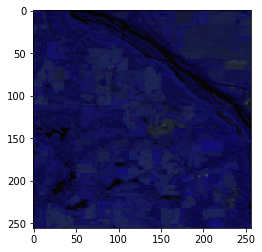

In [50]:
plt.imshow(imgs[0,:,:,2:5])

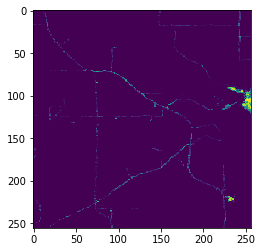

In [40]:
plt.imshow(t[1].numpy()[0,:,:,0])

In [54]:
from tensorflow.python.keras import layers
from tensorflow.python.keras import losses
from tensorflow.python.keras import models
from tensorflow.python.keras import metrics
from tensorflow.python.keras import optimizers

def conv_block(input_tensor, num_filters):
	encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(input_tensor)
	encoder = layers.BatchNormalization()(encoder)
	encoder = layers.Activation('relu')(encoder)
	encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(encoder)
	encoder = layers.BatchNormalization()(encoder)
	encoder = layers.Activation('relu')(encoder)
	return encoder

def encoder_block(input_tensor, num_filters):
	encoder = conv_block(input_tensor, num_filters)
	encoder_pool = layers.MaxPooling2D((2, 2), strides=(2, 2))(encoder)
	return encoder_pool, encoder

def decoder_block(input_tensor, concat_tensor, num_filters):
	decoder = layers.Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding='same')(input_tensor)
	decoder = layers.concatenate([concat_tensor, decoder], axis=-1)
	decoder = layers.BatchNormalization()(decoder)
	decoder = layers.Activation('relu')(decoder)
	decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
	decoder = layers.BatchNormalization()(decoder)
	decoder = layers.Activation('relu')(decoder)
	decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
	decoder = layers.BatchNormalization()(decoder)
	decoder = layers.Activation('relu')(decoder)
	return decoder

def get_model():
	inputs = layers.Input(shape=[None, None, len(BANDS)]) # 256
	encoder0_pool, encoder0 = encoder_block(inputs, 32) # 128
	encoder1_pool, encoder1 = encoder_block(encoder0_pool, 64) # 64
	encoder2_pool, encoder2 = encoder_block(encoder1_pool, 128) # 32
	encoder3_pool, encoder3 = encoder_block(encoder2_pool, 256) # 16
	encoder4_pool, encoder4 = encoder_block(encoder3_pool, 512) # 8
	center = conv_block(encoder4_pool, 1024) # center
	decoder4 = decoder_block(center, encoder4, 512) # 16
	decoder3 = decoder_block(decoder4, encoder3, 256) # 32
	decoder2 = decoder_block(decoder3, encoder2, 128) # 64
	decoder1 = decoder_block(decoder2, encoder1, 64) # 128
	decoder0 = decoder_block(decoder1, encoder0, 32) # 256
	outputs = layers.Conv2D(1, (1, 1), activation='sigmoid')(decoder0)

	model = models.Model(inputs=[inputs], outputs=[outputs])

	model.compile(
		optimizer=optimizers.get(OPTIMIZER), 
		loss=losses.get(LOSS),
		metrics=[metrics.get(metric) for metric in METRICS])

	return model

In [55]:
m = get_model()

m.fit(
    x=training, 
    epochs=EPOCHS, 
    steps_per_epoch=int(TRAIN_SIZE / BATCH_SIZE), 
    validation_data=evaluation,
    validation_steps=EVAL_SIZE)

Train for 1000 steps, validate for 8000 steps
Epoch 1/10
1000/1000 [==============================] - 1121s 1s/step - loss: 0.0456 - root_mean_squared_error: 0.2136


ValueError: Empty training data.